In this notebook we'll expand on what we did in the previous one to try out a few different network structures and look for some promising directions. 

In this network we will be training the models in parallel rather than in series because our data loading function is slow and this makes the best use of it.

In [46]:
import xarray as xr
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt

import time
import glob
import json
import os

from sklearn.utils import shuffle 

import src

In [4]:
# in case we find any bugs to hot fix
import imp
imp.reload(src.data.sat_loader)

<module 'src.data.sat_loader' from '/home/davidjamesfulton93/repos/predict_pv_yield/src/data/sat_loader.py'>

In [5]:
pv_metadata_df = src.data.load_pv.load_pv_metadata("~/repos/predict_pv_yield/data/"+src.data.load_pv.PV_METADATA_FILEPATH)

In [6]:
pv_metadata_df.head()

,system_name,system_size_watts,postcode,number_of_panels,panel_power_watts,panel_brand,num_inverters,inverter_power_watts,inverter_brand,orientation,...,install_date,latitude,longitude,status_interval_minutes,number_of_panels_secondary,panel_power_watts_secondary,orientation_secondary,array_tilt_degrees_secondary,x,y
system_id,,,,,,,,,,,,,,,,,,,,,
690,3.8kw of Power @ No3,3800,NaN,20,190,Phono Solar,1,4000,SMA Sunny Boy 4000,S,...,2010-12-01 00:00:00,52.087171,-0.263414,10,0,0,NaN,NaN,519080.191006,244623.301288
709,Grove Cottages,2460,RG4,12,205,Romag PowerGlaz SMT6(54)P,1,3000,SMA Sunny Boy 3000TL,SE,...,2010-09-28 00:00:00,51.485329,-0.967526,5,0,0,NaN,NaN,471786.316866,176769.072244
777,Underfell1,3420,NaN,18,190,Schuco MPE 190 MS 05,1,4000,SMA Sunny Boy 4000TL,SW,...,2010-10-29 00:00:00,54.197863,-2.938757,10,0,0,NaN,NaN,338853.840270,478417.935178
794,Roofline,3700,GU34,20,185,Sharp,1,4000,SMA,SE,...,2011-01-05 00:00:00,51.112485,-1.032715,5,0,0,NaN,NaN,467806.490433,135244.187025
973,number38,4000,WA11,16,250,Sungrid/SG250M6,1,3800,Sunny Boy 3800,SW,...,2011-01-13 00:00:00,53.467927,-2.675806,5,0,0,NaN,NaN,355234.617987,397009.685712


In [7]:
pv_power_df = src.data.load_pv.load_pv_power(filepath="~/repos/predict_pv_yield/data/"+src.data.load_pv.PV_DATA_FILEPATH, 
                                             start='2018-01-01', end='2019-12-31')

In [8]:
pv_power_df = pv_power_df.dropna(axis=0, how='all')

In [9]:
pv_power_df.head()

,690,709,794,973,1364,1556,1627,1646,1647,1872,...,68000,68212,68218,68219,68303,68324,68404,68443,68800,68846
datetime,,,,,,,,,,,,,,,,,,,,,
2018-01-01 03:30:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 03:35:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 03:40:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 03:45:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-01 03:50:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [10]:
# Drop systems (in-place) without PV data and metadata
src.features.preprocessing.filter_to_power_metadata_match(pv_metadata_df, pv_power_df)

In [11]:
# make clearsky GHI object
latitude, longitude = pv_metadata_df.loc[pv_power_df.columns, ['latitude', 'longitude']].values.T
ghiscalar = src.features.transformers.ClearskyScalar(latitude, longitude, g0=10)

# filter data to daylight hours (in-place)
ghiscalar.filter_to_daylight(pv_power_df, min_ghi=20, inplace=True)

In [12]:
# drop rows systems with no daylight
pv_power_df = pv_power_df.dropna(axis=0, how='all')
src.features.preprocessing.filter_to_power_metadata_match(pv_metadata_df, pv_power_df)

In [13]:
# scale by max power output
rminmax = src.features.transformers.RobustMinMaxScaler(saturation_fraction=0.01)
pv_prop_max_df = rminmax.fit_transform(pv_power_df)

For the satellite and NWP data we will set the loaders to take more than we want. This means we can subset from this for the different networks we train.

In [14]:
pd.set_option('display.max_colwidth', 150)
src.data.sat_loader.AVAILABLE_CHANNELS

,description
channel_name,
VIS006,"λ_central=0.635µm, λ_min=0.56µm, λ_max=0.71µm, | Main observational purposes : Surface, clouds, wind fields"
VIS008,"λ_central=0.81µm, λ_min=0.74µm, λ_max=0.88µm, | Main observational purposes : Surface, clouds, wind fields"
IR_016,"λ_central=1.64µm, λ_min=1.50µm, λ_max=1.78µm, | Main observational purposes : Surface, cloud phase"
IR_039,"λ_central=3.90µm, λ_min=3.48µm, λ_max=4.36µm, | Main observational purposes : Surface, clouds, wind fields"
WV_062,"λ_central=6.25µm, λ_min=5.35µm, λ_max=7.15µm, | Main observational purposes : Water vapor, high level clouds, upper air analysis"
WV_073,"λ_central=7.35µm, λ_min=6.85µm, λ_max=7.85µm, | Main observational purposes : Water vapor, atmospheric instability, upper-level dynamics"
IR_087,"λ_central=8.70µm, λ_min=8.30µm, λ_max=9.1µm, | Main observational purposes : Surface, clouds, atmospheric instability"
IR_097,"λ_central=9.66µm, λ_min=9.38µm, λ_max=9.94µm, | Main observational purposes : Ozone"
IR_108,"λ_central=10.80µm, λ_min=9.80µm, λ_max=11.80µm, | Main observational purposes : Surface, clouds, wind fields, atmospheric instability"


In [15]:
sat_channels = src.data.sat_loader.DEFAULT_CHANNELS
sat_channels

['VIS006',
 'VIS008',
 'IR_016',
 'IR_039',
 'WV_062',
 'WV_073',
 'IR_087',
 'IR_097',
 'IR_108',
 'IR_120',
 'IR_134',
 'HRV']

In [16]:
# set up sat loader with high resolutipon visual and a couple of infrared channels
satloader = src.data.sat_loader.SatelliteLoader(height=22000, width=22000, channels=sat_channels)

In [17]:
src.data.nwp_loader.AVAILABLE_CHANNELS

,description
channel_name,
t,1.5m air temperature at surface
r,1.5m Relative humidity
dpt,1.5m dew point temperature
vis,1.5m visibility
si10,10m wind speed
wdir10,10m wind direction
prmsl,Mean sea level pressure
unknown_1,Uncertain. This is likely '1.5m fog probability'
unknown_2,Uncertain. This is likely 'snow fraction'


In [18]:
nwp_channels = ['t', 'r', 'vis', 'prmsl', 'prate', 'lcc', 'mcc', 'hcc', 'dswrf']

In [19]:
# set up NWP loader with some obvious seeming channels (this takes a minute or two)
nwploader = src.data.nwp_loader.NWPLoader(height=22000, width=22000, channels=nwp_channels)

quick peak at the zarr datasets within the loaders

In [20]:
satloader.dataset

,Array,Chunk
Bytes,3.02 TB,18.52 MB
Shape,"(12, 163137, 704, 548)","(12, 1, 704, 548)"
Count,652549 Tasks,163137 Chunks
Type,float32,numpy.ndarray


In [21]:
nwploader.dataset

,Array,Chunk
Bytes,310.72 GB,15.43 MB
Shape,"(5442, 37, 704, 548)","(1, 10, 704, 548)"
Count,49244 Tasks,21768 Chunks
Type,float32,numpy.ndarray


Set up train and test datasets

In [22]:
# number of time-points to train on and number of systems
n_train_times = int(pv_prop_max_df.shape[0]*0.8)
n_train_systems = int(pv_prop_max_df.shape[1]*0.8)

# shuffle the systems in case they are in significant order
shuffled_columns = shuffle(pv_prop_max_df.columns)
train_columns = shuffled_columns[:n_train_systems]
test_columns = shuffled_columns[n_train_systems:]

# Would be better to train on earlier data and test on later data
# however this is just an example and we only have 2 years data
# therefore we'll shuffle
shuffled_times = shuffle(pv_prop_max_df.index)
train_times = shuffled_times[:n_train_times]
test_times = shuffled_times[n_train_times:]

# train set
y_train = pv_prop_max_df.reindex(index=train_times, columns=train_columns, copy=False)

# test sets
# same systems different times
y_test_time = pv_prop_max_df.reindex(index=test_times, columns=train_columns, copy=False)

# same times different systems
y_test_system = pv_prop_max_df.reindex(index=train_times, columns=test_columns, copy=False)

# different systems and different times
y_test_systemtime = pv_prop_max_df.reindex(index=test_times, columns=test_columns, copy=False)

In [23]:
y_meta_train = pv_metadata_df.reindex(y_train.columns, copy=False)

In [24]:
y_train

,60164,37661,17559,34000,62236,11225,6980,59125,55313,57751,...,2421,28085,15980,42109,34292,4916,27336,44708,2241,27003
datetime,,,,,,,,,,,,,,,,,,,,,
2018-07-29 09:50:00+00:00,NaN,0.130071,0.113485,0.217513,NaN,0.106054,0.091043,0.081511,0.054448,0.199313,...,0.447059,0.147761,0.074286,0.069245,NaN,0.041344,0.108849,0.258197,0.235043,0.172662
2019-06-25 08:25:00+00:00,0.081096,0.216490,NaN,0.705150,0.159015,0.636852,0.194567,0.424254,0.174701,0.096220,...,0.052941,NaN,0.188571,NaN,NaN,0.087117,0.046017,0.136270,0.132479,0.122302
2018-07-20 14:00:00+00:00,NaN,0.224427,0.170228,0.625951,NaN,0.461678,NaN,0.897018,1.000000,0.546392,...,0.652941,0.225617,0.219643,0.114417,NaN,0.483204,0.630528,0.197234,0.970085,0.158273
2018-05-10 11:40:00+00:00,NaN,1.000000,1.000000,0.614354,NaN,0.930215,0.602790,NaN,1.000000,0.594502,...,1.000000,0.643784,1.000000,NaN,NaN,0.343669,0.402211,1.000000,0.730769,0.863309
2019-06-30 18:05:00+00:00,0.035327,0.110229,NaN,0.088533,0.047352,0.063316,0.469530,0.099404,0.154319,0.034364,...,0.082353,NaN,NaN,0.053016,NaN,0.063492,0.660617,0.035348,NaN,0.064748
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-05-29 14:50:00+00:00,NaN,0.162698,0.909982,0.450017,NaN,0.237434,NaN,0.307753,0.101909,0.123711,...,0.158824,0.178736,0.336786,0.701379,NaN,0.180509,0.023894,0.018443,0.106838,0.028777
2018-04-11 17:30:00+00:00,NaN,0.048501,0.002102,0.113141,NaN,0.006859,0.012849,NaN,0.064348,0.010309,...,0.011765,0.000000,0.093929,0.010820,NaN,0.000000,0.000000,0.017930,0.303419,0.014388
2019-01-28 14:25:00+00:00,NaN,0.597443,NaN,NaN,NaN,0.220550,0.164097,0.765408,0.465287,0.302405,...,0.370588,0.549184,0.082143,NaN,NaN,0.602805,0.446458,0.045082,0.196581,0.474820


Lets have a quick go at training a neural network

In [25]:
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import torch

In [26]:
def conv_output_size(H_in, kernel_size, padding, dilation, stride):
    return int((H_in+2*padding - dilation * (kernel_size-1)-1)/stride + 1)

conv_output_size(7, 5, 0, 1, 1)

3

In [27]:

class Net(nn.Module):
    def __init__(self, net_sat_channels, 
                 net_nwp_channels, 
                 conv_hidden_units,
                 image_side_length = 11,
                 conv_kernel_size=5, 
                 fc_hidden_units=[1], 
                 conv_batchnorm=False,
                 fc_batchnorm=False,
                 activation=nn.LeakyReLU(),
                 output_activation=F.relu,
                 dropout_frac=0.):
        
        self.config = dict(
                 net_sat_channels=net_sat_channels, 
                 net_nwp_channels=net_nwp_channels, 
                 conv_hidden_units=conv_hidden_units,
                 image_side_length=image_side_length,
                 conv_kernel_size=conv_kernel_size, 
                 fc_hidden_units=fc_hidden_units, 
                 conv_batchnorm=conv_batchnorm,
                 fc_batchnorm=fc_batchnorm,
                 activation=str(activation),
                 output_activation=str(output_activation),
                 dropout_frac=dropout_frac
        )
        
        super(Net, self).__init__()
        #nn.Dropout2d ()
        # save channel indexes
        self.sat_indexes = [i for i, channel in enumerate(sat_channels) if channel in net_sat_channels]
        self.nwp_indexes = [i for i, channel in enumerate(nwp_channels) if channel in net_nwp_channels]
        
        self.conv_hidden_units = conv_hidden_units
        self.conv_batchnorm = conv_batchnorm
        
        self.fc_hidden_units = fc_hidden_units
        self.fc_batchnorm = fc_batchnorm
        
        self.dropout_frac = dropout_frac
        self.activation = activation
        self.output_activation = output_activation
        
        # set up convolutional layers
        if len(conv_hidden_units)>0:
            self.convs = [nn.Conv2d(in_channels=len(net_sat_channels)+len(net_nwp_channels), 
                                    out_channels=self.conv_hidden_units[0],
                                    kernel_size=conv_kernel_size)]
            self.convs.extend([nn.Conv2d(in_channels=self.conv_hidden_units[i-1], 
                                    out_channels=self.conv_hidden_units[i],
                                    kernel_size=conv_kernel_size)
                         for i in range(1,len(self.conv_hidden_units))])
        
        #  set up convolutional batch-norms
        if conv_batchnorm:
            self.conv_norm = [nn.BatchNorm2d(c) for c in conv_hidden_units]
        
        # keep track of convolutional image size
        self.image_sizes = [image_side_length]
        for i in range(len(conv_hidden_units)):
            self.image_sizes.append(conv_output_size(self.image_sizes[-1], conv_kernel_size, 0, 1, 1))
        
        # set up fully connected layers
        if len(fc_hidden_units)>0:
            self.fc = [nn.Linear(self.image_sizes[-1]**2*self.conv_hidden_units[-1]+1, fc_hidden_units[0])] 
            self.fc.extend([nn.Linear(fc_hidden_units[i-1], fc_hidden_units[i]) for i in range(1,len(fc_hidden_units))])
            
        # set up convolutional batch norms
        if fc_batchnorm:
            self.fc_norm = [nn.BatchNorm1d(h) for h in fc_hidden_units]
        
        
        if dropout_frac>0:
            self.dropout = nn.Dropout(p=dropout_frac)
            
        # compile layers
        l = []
        if len(conv_hidden_units)>0: l+=self.convs
        if conv_batchnorm:           l+= self.conv_norm
        if len(fc_hidden_units)>0:   l+=self.fc
        if fc_batchnorm:             l+=self.fc_norm
        
        self.module_list = nn.ModuleList(l)


    def forward(self, batch):
        
        if len(self.sat_indexes)>0 and len(self.nwp_indexes)>0:
            x = torch.cat((batch['satellite'][:,self.sat_indexes], batch['nwp'][:, self.nwp_indexes]), dim=1)
        elif len(self.sat_indexes)>0:
            x = batch['satellite'][:,self.sat_indexes]
        elif len(self.nwp_indexes)>0:
            x = batch['nwp'][:, self.nwp_indexes]
        
        for i in range(len(self.convs)):
            x = self.convs[i](x)
            if self.conv_batchnorm:
                x = self.conv_norm[i](x)
            if self.dropout_frac>0:
                x = self.dropout(x)
            x = self.activation(x)
        
        x = x.view(x.shape[0], -1)
        x = torch.cat((x, batch['day_fraction'].view(-1,1)), dim=1)

        for i in range(len(self.fc)):
            x = self.fc[i](x)
            if i!=len(self.fc)-1:
                if self.conv_batchnorm:
                    x = self.fc_norm[i](x)
                if self.dropout_frac>0:
                    x = self.dropout(x)
                x = self.activation(x)
                
        x = self.output_activation(x)
        
        return x

In [35]:
MSE_LOSS_FUNC = nn.MSELoss()
MAE_LOSS_FUNC = nn.L1Loss()
MODEL_DUMP_ROOT = os.path.expanduser('~/model_dump')

class net_container:
    def __init__(self, net, optimizer, loss_func=nn.MSELoss(), run_name=None):
        self.net = net
        self.optimizer = optimizer
        self.loss_func = loss_func
        self.run_name = run_name
        
        self.running_train_loss = 0
        self.running_train_mse = 0
        self.running_train_mae = 0
        
        self.train_losses = []
        self.train_mse_losses = []
        self.train_mae_losses = []
        
        self.test_losses = []
        self.test_mse_losses = []
        self.test_mae_losses = []
        self.batch = []
        self.time_elapsed = []
        
    
    def train_step(self, batch, batch_number):
        
        # zero the parameter gradients
        self.optimizer.zero_grad()

        # forward + backward + optimize
        self.net.train()
        
        outputs = self.net(batch)
        train_loss = self.loss_func(outputs, batch['y'])
        self.running_train_loss += train_loss.item()
        
        train_loss.backward()
        self.optimizer.step()
        
        # MAE
        train_mae = MAE_LOSS_FUNC(outputs, batch['y'])
        self.running_train_mae += train_mae.item()
        
        # MSE
        train_mse = MSE_LOSS_FUNC(outputs, batch['y'])
        self.running_train_mse += train_mse.item()

        # print statistics
        if batch_number == 0 or batch_number % STATS_PERIOD == STATS_PERIOD - 1:    # print every STATS_PERIOD mini-batches

            # Train loss
            if batch_number == 0:
                mean_train_loss = self.running_train_loss
                mean_train_mse = self.running_train_mse
                mean_train_mae = self.running_train_mae
                self.t0 = time.time()
            else:
                mean_train_loss = self.running_train_loss / STATS_PERIOD
                mean_train_mse = self.running_train_mse / STATS_PERIOD
                mean_train_mae = self.running_train_mae / STATS_PERIOD

            self.train_losses.append(mean_train_loss)
            self.train_mse_losses.append(mean_train_mse)
            self.train_mae_losses.append(mean_train_mae)
            
            self.running_train_loss = 0.
            self.running_train_mse = 0.
            self.running_train_mae = 0.

            # Test loss
            self.net.eval()
            test_outputs = self.net(test_batch)
            
            test_loss = self.loss_func(test_outputs, test_batch['y']).item()
            self.test_losses.append(test_loss)
            test_mae = MAE_LOSS_FUNC(test_outputs, test_batch['y']).item()
            self.test_mae_losses.append(test_mae)
            test_mse = MSE_LOSS_FUNC(test_outputs, test_batch['y']).item()
            self.test_mse_losses.append(test_mse)
            
            self.batch.append(batch_number)
            self.time_elapsed.append(time.time() - self.t0)
            
            if self.run_name:
                thisdir = os.path.join(MODEL_DUMP_ROOT, self.run_name)
                if batch_number==0:
                    
                    os.system(f"rm -rf {thisdir}")
                    os.makedirs(os.path.join(thisdir, "figures"))
                    
                    with open(os.path.join(thisdir, 'config.json'), 'w') as f:
                        json.dump(self.net.config, f, indent=4)
                              
                df = pd.DataFrame({
                    'time_elapsed':self.time_elapsed,
                    'batch':self.batch,
                    'train_loss':self.train_losses,
                    'train_mse':self.train_mse_losses,
                    'train_mae':self.train_mae_losses,
                    'test_loss':self.test_losses,
                    'test_mse':self.test_mse_losses,
                    'test_mae':self.test_mae_losses,
                }).to_csv(os.path.join(thisdir, 'training_stats.csv'))
                
                if test_loss == min(self.test_losses):
                    torch.save(self.net, os.path.join(thisdir, 'best_model.pkl'))
                    

In [29]:
# create training batch generator
batch_generator = src.data.batch_loader.cross_processor_batch(
            y_train, 
            y_meta_train, 
            clearsky=None,
            sat_loader=satloader,
            nwp_loader=nwploader,
            lead_time=pd.Timedelta('0 days 00:00:00'),
            batch_size=256, 
            batches_per_superbatch=400, 
            n_superbatches=None, 
            n_epochs=3, 
            gpu=False,
            consec_samples_per_datetime=100,
            parallel_loading_cores=2)

In [30]:
# Grab a test batch!
# This may take a minute or two.
test_batch_generator = src.data.batch_loader.cross_processor_batch(
            y_test_systemtime, 
            pv_metadata_df.reindex(y_test_systemtime.columns, copy=False), 
            clearsky=None,
            sat_loader=satloader,
            nwp_loader=nwploader,
            lead_time=pd.Timedelta('0 days 00:00:00'),
            batch_size=2000, 
            batches_per_superbatch=1, 
            n_superbatches=1, 
            n_epochs=None, 
            gpu=False,
            consec_samples_per_datetime=2,
            parallel_loading_cores=2)

%time test_batch = next(test_batch_generator)

# arrays have shape 1 on final axis. The network doesn't like this in x
test_batch = {k:torch.from_numpy(v.astype(np.float32)[...,0]) 
                  if k!='y' else torch.from_numpy(v.astype(np.float32)) 
              for k,v in test_batch.items()}

CPU times: user 26min 35s, sys: 2min 39s, total: 29min 15s
Wall time: 15min 49s


In [30]:
sat_base_net = Net(
           ['IR_016','IR_039','WV_062','IR_087','IR_108','IR_134','HRV'],
           [], 
           conv_hidden_units=[10],
           image_side_length = 11,
           conv_kernel_size=5,
           fc_hidden_units=[20,6,1],
           conv_batchnorm=True,
           fc_batchnorm=True,
           activation=nn.LeakyReLU(),
           output_activation=F.relu,
           dropout_frac=0.
)

sat_base_net_sigmoid = Net(
           ['IR_016','IR_039','WV_062','IR_087','IR_108','IR_134','HRV'],
           [], 
           conv_hidden_units=[10],
           image_side_length = 11,
           conv_kernel_size=5,
           fc_hidden_units=[20,6,1],
           conv_batchnorm=True,
           fc_batchnorm=True,
           activation=nn.LeakyReLU(),
           output_activation=nn.Sigmoid(),
           dropout_frac=0.
)

nwp_base_net = Net(
           [],
           ['t', 'r', 'prmsl', 'lcc', 'mcc', 'hcc', 'dswrf'], 
           conv_hidden_units=[10],
           image_side_length = 11,
           conv_kernel_size=5,
           fc_hidden_units=[20,6,1],
           conv_batchnorm=True,
           fc_batchnorm=True,
           activation=nn.LeakyReLU(),
           output_activation=F.relu,
           dropout_frac=0.
)

hybrid_base_net = Net(
           ['IR_016','IR_039','WV_062','IR_087','IR_108','IR_134','HRV'],
           ['t', 'r', 'prmsl', 'lcc', 'mcc', 'hcc', 'dswrf'], 
           conv_hidden_units=[10],
           image_side_length = 11,
           conv_kernel_size=5,
           fc_hidden_units=[20,6,1],
           conv_batchnorm=True,
           fc_batchnorm=True,
           activation=nn.LeakyReLU(),
           output_activation=F.relu,
           dropout_frac=0.
)

big_sat_net = Net(
           ['VIS006','VIS008','IR_016','IR_039','WV_062','WV_073','IR_087','IR_097','IR_108','IR_120','IR_134','HRV'],
           [], 
           conv_hidden_units=[50, 50],
           image_side_length = 11,
           conv_kernel_size=5,
           fc_hidden_units=[100, 100, 20, 1],
           conv_batchnorm=False,
           fc_batchnorm=False,
           activation=nn.LeakyReLU(),
           output_activation=F.relu,
           dropout_frac=0.
)

big_nwp_net = Net(
           [],
           ['t', 'r', 'vis', 'prmsl', 'prate', 'lcc', 'mcc', 'hcc', 'dswrf'], 
           conv_hidden_units=[50, 50],
           image_side_length = 11,
           conv_kernel_size=5,
           fc_hidden_units=[100, 100, 20, 1],
           conv_batchnorm=False,
           fc_batchnorm=False,
           activation=nn.LeakyReLU(),
           output_activation=F.relu,
           dropout_frac=0.
)

big_hybrid_net = Net(
           ['VIS006','VIS008','IR_016','IR_039','WV_062','WV_073','IR_087','IR_097','IR_108','IR_120','IR_134','HRV'],
           ['t', 'r', 'vis', 'prmsl', 'prate', 'lcc', 'mcc', 'hcc', 'dswrf'], 
           conv_hidden_units=[50, 50],
           image_side_length = 11,
           conv_kernel_size=5,
           fc_hidden_units=[100, 100, 20, 1],
           conv_batchnorm=False,
           fc_batchnorm=False,
           activation=nn.LeakyReLU(),
           output_activation=F.relu,
           dropout_frac=0.
)

In [31]:
sat_base_container = net_container(
    sat_base_net, 
    optimizer=optim.SGD(sat_base_net.parameters(), lr=0.01, momentum=0.8), 
    loss_func=nn.MSELoss(),
    run_name='sat_base',
)

sat_base_sigmoid_container = net_container(
    sat_base_net_sigmoid, 
    optimizer=optim.SGD(sat_base_net_sigmoid.parameters(), lr=0.01, momentum=0.8), 
    loss_func=nn.MSELoss(),
    run_name='sat_base_sigmoid',
)

nwp_base_container = net_container(
    nwp_base_net, 
    optimizer=optim.SGD(nwp_base_net.parameters(), lr=0.01, momentum=0.8), 
    loss_func=nn.MSELoss(),
    run_name='nwp_base'
)

hybrid_base_container = net_container(
    hybrid_base_net, 
    optimizer=optim.SGD(hybrid_base_net.parameters(), lr=0.01, momentum=0.8), 
    loss_func=nn.MSELoss(),
    run_name='hybrid_base',

)

big_sat_container = net_container(
    big_sat_net, 
    optimizer=optim.SGD(big_sat_net.parameters(), lr=0.01, momentum=0.8), 
    loss_func=nn.MSELoss(),
    run_name='sat_big',
)

big_nwp_container = net_container(
    big_nwp_net, 
    optimizer=optim.SGD(big_nwp_net.parameters(), lr=0.01, momentum=0.8), 
    loss_func=nn.MSELoss(),
    run_name='nwp_big',
)

big_hybrid_container = net_container(
    big_hybrid_net, 
    optimizer=optim.SGD(big_hybrid_net.parameters(), lr=0.01, momentum=0.8), 
    loss_func=nn.MSELoss(),
    run_name='hybrid_big',
)

containers = [sat_base_container, sat_base_sigmoid_container, nwp_base_container, 
              hybrid_base_container, big_sat_container, big_nwp_container,
              big_hybrid_container]

In [43]:
STATS_PERIOD = 100 # batch_generator.batches_per_superbatch

In [ ]:
shuffles_per_superbatch = 4
current_shuffles = 1

for i_batch, batch in enumerate(batch_generator):
    
    print(f'batch:{i_batch}\r', end="")
    
    batch = {k:torch.from_numpy(v.astype(np.float32)[...,0]) if k!='y' 
                 else torch.from_numpy(v.astype(np.float32)) 
             for k,v in batch.items()}
    
    for container in containers:
        container.train_step(batch, i_batch)
        
    # if we have got to end of superbatch reshuffle
    if batch_generator.batch_index==(batch_generator.batches_per_superbatch-1):
        # but only if we haven't already shuffled so mnay times
        if current_shuffles < shuffles_per_superbatch:
            print(f'batch:{i_batch} - reshuffling super-batch\r', end="")
            batch_generator.shuffle_cpu_superbatch()
            if batch_generator.gpu: batch_generator.transfer_superbatch_to_gpu()
            batch_generator.batch_index = 0
            current_shuffles+=1
        # if we have shiuffled our limit of times then update shuffle tally
        elif current_shuffles >= shuffles_per_superbatch:
            print(f'batch:{i_batch} - reshuffled this super-batch too many times. Loading new.\r', end="")
            current_shuffles = 1


print('\nFinished Training')

/home/davidjamesfulton93/repos/predict_pv_yield/src/data/batch_loader.py:373: UserWarning: 
                            exceeded 20. This may imply a data issue.
                            
                            
  """.format(repeats))


In [32]:
model_dumps = ['sat_base', 'sat_base_sigmoid', 'nwp_base', 
               'hybrid_base', 'sat_big', 'nwp_big', 'hybrid_big']


dfs = [pd.read_csv(f'~/model_dump/{model}/training_stats.csv', )\
                       .drop('Unnamed: 0', axis=1).set_index('batch')\
       for model in model_dumps]

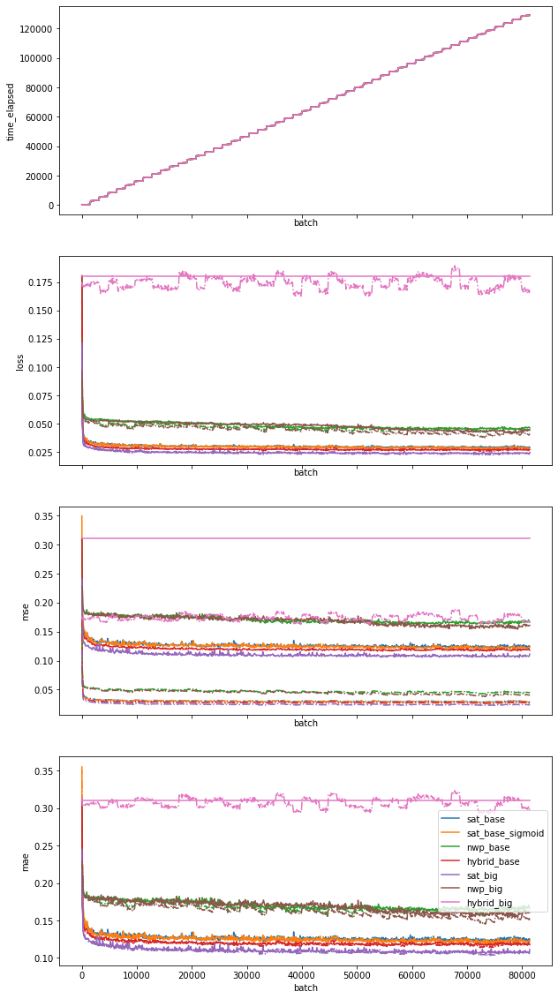

In [33]:
from itertools import cycle
prop_cycle = plt.rcParams['axes.prop_cycle']


fig, axes = plt.subplots(4,1, sharex=True, figsize=(10,20))
axes = axes.flatten()
plot_metrics = ['time_elapsed', 'loss', 'mse', 'mae']

for ax, metric in zip(axes, plot_metrics):
    colors = cycle(prop_cycle.by_key()['color'])
    
    for i in range(len(model_dumps)):
        c = next(colors)
        if metric=='time_elapsed':
            ax.plot(dfs[i].index, dfs[i][metric], label=model_dumps[i], color=c)
        else:
            ax.plot(dfs[i].index, dfs[i]['train_'+metric], linestyle='-.', color=c)
            ax.plot(dfs[i].index, dfs[i]['test_'+metric], linestyle='-', label=model_dumps[i], color=c)
    ax.set_xlabel('batch')
    ax.set_ylabel(metric)
ax.legend()
plt.show()

In [34]:
final_results_df = {}
for i,model in enumerate(model_dumps):
    df = dfs[i].iloc[-100:].mean() # covers last 10000 batches
    for ind in df.index:
        if ind in final_results_df.keys():
            final_results_df[ind].append(df[ind])
        else:
            final_results_df[ind] = [df[ind]] 
pd.DataFrame(final_results_df, index=model_dumps)

,time_elapsed,train_loss,train_mse,train_mae,test_loss,test_mse,test_mae
sat_base,122210.404429,0.029320,0.029320,0.123968,0.029500,0.124336,0.124336
sat_base_sigmoid,122210.311084,0.028606,0.028606,0.121995,0.028781,0.122161,0.122161
nwp_base,122210.196702,0.044896,0.044896,0.162328,0.046048,0.165880,0.165880
hybrid_base,122210.114678,0.027025,0.027025,0.117286,0.027247,0.118489,0.118489
sat_big,122210.138993,0.023580,0.023580,0.106407,0.024260,0.107824,0.107824
nwp_big,122210.051480,0.040760,0.040760,0.152303,0.043570,0.158943,0.158943
hybrid_big,122210.055774,0.171736,0.171736,0.303521,0.180443,0.310516,0.310516


In the above graphs I made some mistakes. The first being a typo which means in the MSE graph the test (solid) line is actually the MAE.

The next is forgetting to batch norm the bigger models. So with that in mind lets train some more.

Considering the train and test loosses are essentially the same suggests that we are undertrained and so bigger networks could get us better performance. So lets try that too.

In [40]:
# redo this set with batchnorm
big_sat_net2 = Net(
           ['VIS006','VIS008','IR_016','IR_039','WV_062','WV_073','IR_087','IR_097','IR_108','IR_120','IR_134','HRV'],
           [], 
           conv_hidden_units=[50, 50],
           image_side_length = 11,
           conv_kernel_size=5,
           fc_hidden_units=[100, 100, 20, 1],
           conv_batchnorm=True,
           fc_batchnorm=True,
           activation=nn.LeakyReLU(),
           output_activation=F.relu,
           dropout_frac=0.
)

big_nwp_net2 = Net(
           [],
           ['t', 'r', 'vis', 'prmsl', 'prate', 'lcc', 'mcc', 'hcc', 'dswrf'], 
           conv_hidden_units=[50, 50],
           image_side_length = 11,
           conv_kernel_size=5,
           fc_hidden_units=[100, 100, 20, 1],
           conv_batchnorm=True,
           fc_batchnorm=True,
           activation=nn.LeakyReLU(),
           output_activation=F.relu,
           dropout_frac=0.
)

big_hybrid_net2 = Net(
           ['VIS006','VIS008','IR_016','IR_039','WV_062','WV_073','IR_087','IR_097','IR_108','IR_120','IR_134','HRV'],
           ['t', 'r', 'vis', 'prmsl', 'prate', 'lcc', 'mcc', 'hcc', 'dswrf'], 
           conv_hidden_units=[50, 50],
           image_side_length = 11,
           conv_kernel_size=5,
           fc_hidden_units=[100, 100, 20, 1],
           conv_batchnorm=True,
           fc_batchnorm=True,
           activation=nn.LeakyReLU(),
           output_activation=F.relu,
           dropout_frac=0.
)

# make some bigger networks
bigger_sat_net = Net(
           ['VIS006','VIS008','IR_016','IR_039','WV_062','WV_073','IR_087','IR_097','IR_108','IR_120','IR_134','HRV'],
           [], 
           conv_hidden_units=[100, 100],
           image_side_length = 11,
           conv_kernel_size=5,
           fc_hidden_units=[200, 200, 100, 50, 20, 1],
           conv_batchnorm=True,
           fc_batchnorm=True,
           activation=nn.LeakyReLU(),
           output_activation=F.relu,
           dropout_frac=0.
)

bigger_nwp_net = Net(
           [],
           ['t', 'r', 'vis', 'prmsl', 'prate', 'lcc', 'mcc', 'hcc', 'dswrf'], 
           conv_hidden_units=[100, 100],
           image_side_length = 11,
           conv_kernel_size=5,
           fc_hidden_units=[200, 200, 100, 50, 20, 1],
           conv_batchnorm=True,
           fc_batchnorm=True,
           activation=nn.LeakyReLU(),
           output_activation=F.relu,
           dropout_frac=0.
)

bigger_hybrid_net = Net(
           ['VIS006','VIS008','IR_016','IR_039','WV_062','WV_073','IR_087','IR_097','IR_108','IR_120','IR_134','HRV'],
           ['t', 'r', 'vis', 'prmsl', 'prate', 'lcc', 'mcc', 'hcc', 'dswrf'], 
           conv_hidden_units=[100, 100],
           image_side_length = 11,
           conv_kernel_size=5,
           fc_hidden_units=[200, 200, 100, 50, 20, 1],
           conv_batchnorm=True,
           fc_batchnorm=True,
           activation=nn.LeakyReLU(),
           output_activation=F.relu,
           dropout_frac=0.
)

In [41]:
# redo networks
big_sat_container2 = net_container(
    big_sat_net2, 
    optimizer=optim.SGD(big_sat_net2.parameters(), lr=0.01, momentum=0.8), 
    loss_func=nn.MSELoss(),
    run_name='sat_big_bn',
)

big_nwp_container2 = net_container(
    big_nwp_net2, 
    optimizer=optim.SGD(big_nwp_net2.parameters(), lr=0.01, momentum=0.8), 
    loss_func=nn.MSELoss(),
    run_name='nwp_big_bn',
)

big_hybrid_container2 = net_container(
    big_hybrid_net2, 
    optimizer=optim.SGD(big_hybrid_net2.parameters(), lr=0.01, momentum=0.8), 
    loss_func=nn.MSELoss(),
    run_name='hybrid_big_bn',
)

# bigger network
bigger_sat_container = net_container(
    bigger_sat_net, 
    optimizer=optim.SGD(bigger_sat_net.parameters(), lr=0.01, momentum=0.8), 
    loss_func=nn.MSELoss(),
    run_name='sat_bigger',
)

bigger_nwp_container = net_container(
    bigger_nwp_net, 
    optimizer=optim.SGD(bigger_nwp_net.parameters(), lr=0.01, momentum=0.8), 
    loss_func=nn.MSELoss(),
    run_name='nwp_bigger',
)

bigger_hybrid_container = net_container(
    bigger_hybrid_net, 
    optimizer=optim.SGD(bigger_hybrid_net.parameters(), lr=0.01, momentum=0.8), 
    loss_func=nn.MSELoss(),
    run_name='hybrid_bigger',
)

containers2 = [big_sat_container2, big_nwp_container2, big_hybrid_container2,
             bigger_sat_container, bigger_nwp_container, bigger_hybrid_container]

In [ ]:
shuffles_per_superbatch = 4
current_shuffles = 1

for i_batch, batch in enumerate(batch_generator):
    
    print(f'batch:{i_batch}\r', end="")
    
    batch = {k:torch.from_numpy(v.astype(np.float32)[...,0]) if k!='y' 
                 else torch.from_numpy(v.astype(np.float32)) 
             for k,v in batch.items()}
    
    for container in containers2:
        container.train_step(batch, i_batch)
        
    # if we have got to end of superbatch reshuffle
    if batch_generator.batch_index==(batch_generator.batches_per_superbatch-1):
        # but only if we haven't already shuffled so mnay times
        if current_shuffles < shuffles_per_superbatch:
            print(f'batch:{i_batch} - reshuffling super-batch\r', end="")
            batch_generator.shuffle_cpu_superbatch()
            if batch_generator.gpu: batch_generator.transfer_superbatch_to_gpu()
            batch_generator.batch_index = 0
            current_shuffles+=1
        # if we have shiuffled our limit of times then update shuffle tally
        elif current_shuffles >= shuffles_per_superbatch:
            print(f'batch:{i_batch} - reshuffled this super-batch too many times. Loading new.\r', end="")
            current_shuffles = 1


print('\nFinished Training')

/opt/conda/lib/python3.7/site-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type Net. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


/home/davidjamesfulton93/repos/predict_pv_yield/src/data/batch_loader.py:373: UserWarning: 
                            exceeded 20. This may imply a data issue.
                            
                            
  """.format(repeats))


In [58]:
model_dumps = [x.split('/')[-1] for x in glob.glob(os.path.expanduser('~/model_dump/*')) if not x.endswith('ipynb')]
model_dumps = sorted(model_dumps, key=lambda x: '_'.join(x.split('_')[1:])+x.split('_')[1:])

['nwp_base',
 'sat_base',
 'hybrid_base',
 'sat_base_sigmoid',
 'nwp_big',
 'sat_big',
 'sat_big_bn',
 'nwp_big_bn',
 'hybrid_big_bn',
 'hybrid_bigger',
 'sat_bigger',
 'nwp_bigger']

In [52]:
# load in the training curves
dfs = [pd.read_csv(f'~/model_dump/{model}/training_stats.csv', )\
                       .drop('Unnamed: 0', axis=1).set_index('batch')\
       for model in model_dumps]

In [53]:
from itertools import cycle
prop_cycle = plt.rcParams['axes.prop_cycle']
sns.set()

In [55]:
def plot_training_curves(i_min=0):
    fig, axes = plt.subplots(4,1, sharex=True, figsize=(10,20))
    axes = axes.flatten()
    plot_metrics = ['time_elapsed', 'loss', 'mse', 'mae']

    for ax, metric in zip(axes, plot_metrics):
        colors = cycle(prop_cycle.by_key()['color'])

        for i in range(len(model_dumps)):
            c = next(colors)
            df_ = dfs[i].iloc[i_min:]
            if metric=='time_elapsed':
                ax.plot(df_.index, df_[metric], label=model_dumps[i], color=c)
            else:
                ax.plot(df_.index, df_['train_'+metric], linestyle='-.', color=c)
                ax.plot(df_.index, df_['test_'+metric], linestyle='-', label=model_dumps[i], color=c)
        ax.set_xlabel('batch')
        ax.set_ylabel(metric)
    ax.legend()
    plt.show()

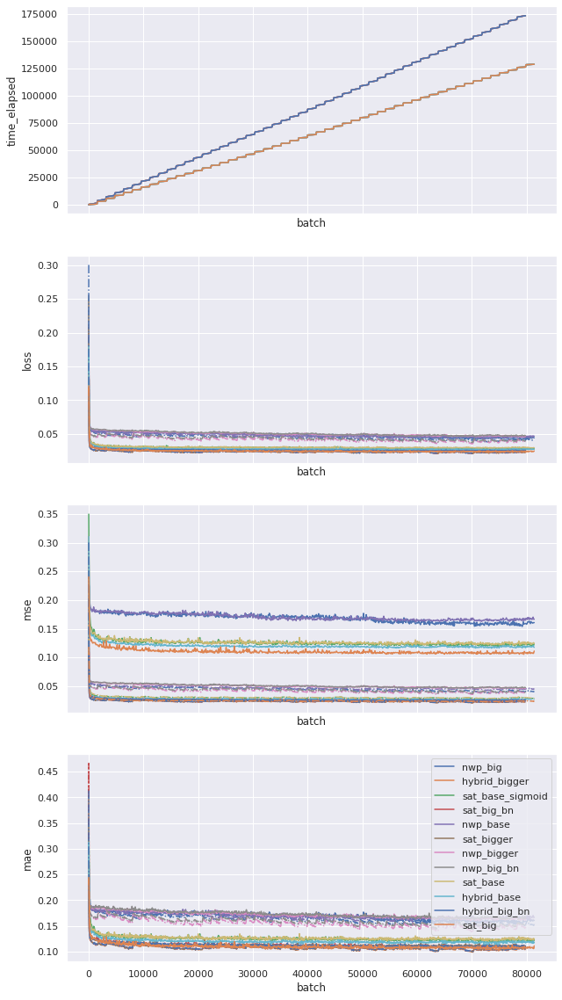

In [56]:
plot_training_curves()

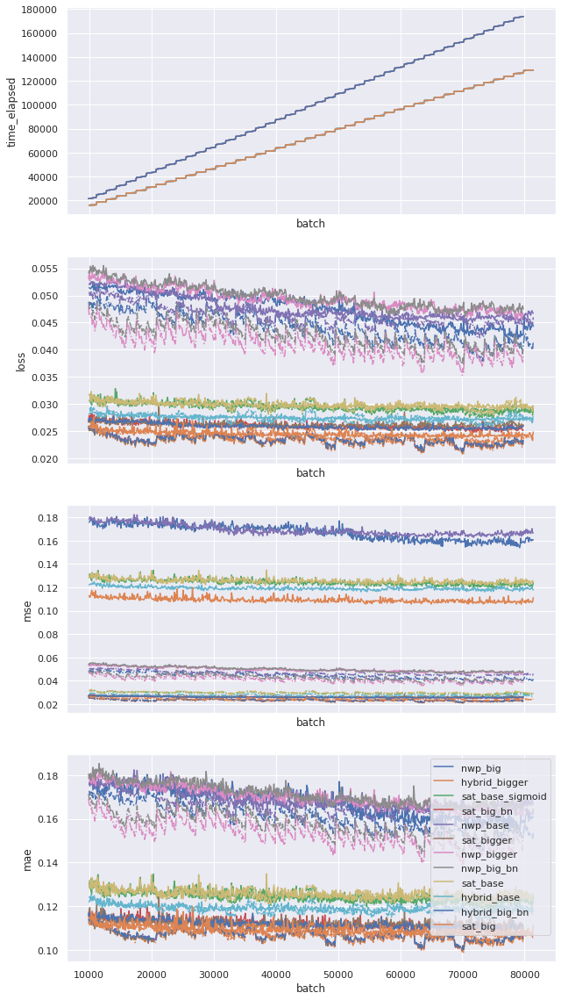

In [57]:
plot_training_curves(100)

In [ ]:
final_results_df = {}
for i,model in enumerate(model_dumps):
    df = dfs[i].iloc[-100:].mean() # covers last 10000 batches
    for ind in df.index:
        if ind in final_results_df.keys():
            final_results_df[ind].append(df[ind])
        else:
            final_results_df[ind] = [df[ind]] 
pd.DataFrame(final_results_df, index=model_dumps).sort_values('test_loss')
